In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Organizziamo le cartelle per dividere i file IMG e TEXT

In [ ]:
import os
from glob import glob
import shutil


dirpath = 'drive/MyDrive/Colab Notebooks/Animal2'


#creiamo le cartelle img e label
img_dir = os.path.join(dirpath, 'img')
label_dir = os.path.join(dirpath, 'label')
os.makedirs(img_dir, exist_ok=True)
os.makedirs(label_dir, exist_ok=True)



In [ ]:

#iteriamo sui file della cartella che contiene tutti gli animali divisi in 4 cartelle
for dirname in os.listdir(dirpath):
    path=os.path.join(dirpath, dirname)   #dirpath ha il path fino ad Animal, dirname ha invece il nome della cartella (rhyno, zebra ecc...)
    file_list = os.listdir(path)
    file_list = sorted(file_list, key=lambda x: int(x.split('.')[0]))
    if path.endswith("img") or path.endswith("label"):
       continue


#ridenominiamo i file
    for file in file_list:       #siccome non possiamo avere nomi uguali di file nella stessa cartella, rinominiamo i file aggiungendo la classe di appartenenza nel nome del file
        nome_file, estensione = os.path.splitext(os.path.join(path, file))
        renamed_file = nome_file + "_" + dirname + estensione
        os.rename(os.path.join(path, file), renamed_file)

In [ ]:
for dirname in os.listdir(dirpath):
    path=os.path.join(dirpath, dirname)
    file_list = os.listdir(path)
    if path.endswith("img") or path.endswith("label"):
       continue

    for file in file_list:
        if file.endswith((".txt")):
            shutil.move(os.path.join(path, file), label_dir)

        elif file.endswith((".jpg", ".JPG")):
            shutil.move(os.path.join(path, file), img_dir)

Vediamo quante immagini e label abbiamo collezionato

In [ ]:
print(len(os.listdir(label_dir)))
print(len(os.listdir(img_dir)))

##**INIZIO CODICE PER IL TRAIN**

Carichiamo tutto il necessario per trattare il DATASET

In [ ]:
import os
import numpy as np
import torch
import sys
from PIL import Image

class AnimalDataset(torch.utils.data.Dataset):
    def __init__(self, root, transforms=None):
        self.root = root
        self.transforms = transforms
        self.imgs = list(sorted(os.listdir(os.path.join(root, "img"))))
        self.labels = list(sorted(os.listdir(os.path.join(root, "label"))))

    def __getitem__(self, idx):
        img_path = os.path.join(self.root, "img", self.imgs[idx])
        label_path = os.path.join(self.root, "label", self.labels[idx])

        img = Image.open(img_path).convert("RGB")

        with open(label_path, "r") as label_file:
            lines = label_file.read().splitlines()    #usiamo splitlines() perchè usando readlines quando la riga torna a capo ci mette il carattere \n che non vogliamo


        boxes = []
        labels = []
        image_id = torch.tensor([idx])
        for line in lines:
            parts = line.strip().split()
            label = int(parts[0])
            # Il primo elemento nella riga è la classe, gli altri sono le coordinate
            x_center, y_center, width, height = map(float, parts[1:])
            # Convertiamo le coordinate YOLO in coordinate di bounding box
            xmin = (x_center - width / 2.0) * img.width
            ymin = (y_center - height / 2.0) * img.height
            xmax = (x_center + width / 2.0) * img.width
            ymax = (y_center + height / 2.0) * img.height

            boxes.append([xmin, ymin, xmax, ymax])
            labels.append(label)

        # Convertiamo i bounding box e le etichette in tensori PyTorch
        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        labels = torch.as_tensor(labels, dtype=torch.int64)

        area = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0])  # Calcola l'area dei bounding box
        iscrowd = torch.zeros((len(boxes),), dtype=torch.int64)

        # Crea il target come un dizionario
        target = {
            "boxes": boxes,
            "labels": labels,
            "image_id": image_id,
            "area": area,
            "iscrowd": iscrowd
        }

        if self.transforms is not None:
            img, target = self.transforms(img, target)

        return img, target

    def __len__(self):
        return len(self.imgs)


In [ ]:
from engine import train_one_epoch, evaluate_train, evaluate_test
import utils
import transforms1 as T


def get_transform(train):
    transforms = []
    #converte l'immagine in un Tensore Pytorch
    transforms.append(T.ToTensor())
    if train:
        # durante il training, effettua un flip random alle immagini
        # come strategia di data augmentation
        transforms.append(T.RandomHorizontalFlip(0.5))
    return T.Compose(transforms)

TEST SULL OGGETTO DEL DATASET

In [ ]:
import matplotlib.pyplot as plt
# Print oggetto
dataset = AnimalDataset('drive/MyDrive/Colab Notebooks/Animal2', get_transform(train=True))
real_image = dataset[3]
real_image

(tensor([[[0.4392, 0.3647, 0.3647,  ..., 0.2980, 0.4078, 0.3765],
          [0.4392, 0.3686, 0.4000,  ..., 0.3529, 0.4667, 0.5137],
          [0.4588, 0.3569, 0.3490,  ..., 0.4039, 0.4706, 0.5451],
          ...,
          [0.6588, 0.6824, 0.5059,  ..., 0.6157, 0.7412, 0.4196],
          [0.4980, 0.5294, 0.5922,  ..., 0.4980, 0.9137, 0.6941],
          [0.1843, 0.3922, 0.5961,  ..., 0.8471, 0.9294, 0.8941]],
 
         [[0.5451, 0.4745, 0.5020,  ..., 0.4118, 0.4745, 0.4667],
          [0.5647, 0.5098, 0.5412,  ..., 0.4706, 0.5333, 0.5686],
          [0.5725, 0.4431, 0.4627,  ..., 0.5765, 0.5765, 0.5529],
          ...,
          [0.6157, 0.6784, 0.5294,  ..., 0.6000, 0.6549, 0.3294],
          [0.6588, 0.5882, 0.7137,  ..., 0.4471, 0.8549, 0.6353],
          [0.3804, 0.5059, 0.5843,  ..., 0.7569, 0.8863, 0.8353]],
 
         [[0.0392, 0.0078, 0.0078,  ..., 0.0000, 0.0980, 0.0196],
          [0.0039, 0.0157, 0.0157,  ..., 0.0000, 0.1647, 0.2745],
          [0.0000, 0.0196, 0.0078,  ...,

FINE TEST OGGETTO DATASET

In [ ]:
import torch
import torchvision
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import requests
from io import BytesIO
import os

Carichiamo il modello RetinaNet

In [ ]:
model = torchvision.models.detection.retinanet_resnet50_fpn_v2(pretrained=True)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=RetinaNet_ResNet50_FPN_V2_Weights.COCO_V1`. You can also use `weights=RetinaNet_ResNet50_FPN_V2_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/retinanet_resnet50_fpn_v2_coco-5905b1c5.pth" to /root/.cache/torch/hub/checkpoints/retinanet_resnet50_fpn_v2_coco-5905b1c5.pth
100%|██████████| 146M/146M [00:01<00:00, 80.8MB/s]


In [ ]:
num_classes = 5

In [ ]:
import math

in_features = model.head.classification_head.conv[0][0].in_channels
num_anchors = model.head.classification_head.num_anchors
model.head.classification_head.num_classes = num_classes

out_channels = model.head.classification_head.conv[0][0].out_channels

cls_logits = torch.nn.Conv2d(out_channels, num_anchors * num_classes, kernel_size = 3, stride=1, padding=1)
torch.nn.init.normal_(cls_logits.weight, std=0.01)
torch.nn.init.constant_(cls_logits.bias, -math.log((1 - 0.01) / 0.01))
model.head.classification_head.cls_logits = cls_logits

FINE TEST

Splittiamo il dataset con 70% train, 20% test e 10% validation

In [ ]:
import torch


torch.manual_seed(1)

# Carichiamo il Dataset per il train
dataset = AnimalDataset('drive/MyDrive/Colab Notebooks/Animal2', get_transform(train=True))
indices = torch.randperm(len(dataset)).tolist()

# Lunghezze per lo split
len_dataset = len(dataset)
len_train = int(0.7 * len_dataset)
len_val = int(0.1 * len_dataset)
len_test = len_dataset - len_train - len_val


dataset_train = torch.utils.data.Subset(dataset, indices[:len_train])

# Dataset di validazione senza la data augmentation
dataset_val = AnimalDataset('drive/MyDrive/Colab Notebooks/Animal2', get_transform(train=False))
dataset_val = torch.utils.data.Subset(dataset_val, indices[len_train:(len_train + len_val)])

# Dataset di test senza la data augmentation
dataset_test = AnimalDataset('drive/MyDrive/Colab Notebooks/Animal2', get_transform(train=False))
dataset_test = torch.utils.data.Subset(dataset_test, indices[(len_train + len_val):])

# Print
print("Numero di elementi nel set di addestramento:", len(dataset_train))
print("Numero di elementi nel set di validazione:", len(dataset_val))
print("Numero di elementi nel set di test:", len(dataset_test))

Numero di elementi nel set di addestramento: 1052
Numero di elementi nel set di validazione: 150
Numero di elementi nel set di test: 302


In [ ]:
def count_images_per_class(dataset):        #calcola il numero di animali, per etichetta, per ogni dataset (per capirne un po la distribuzione)
    class_count = {}
    for _, target in dataset:
        labels = target['labels']
        for label in labels:
            label = label.item()
            if label in class_count:
                class_count[label] += 1
            else:
                class_count[label] = 1
    return class_count


train_class_count = count_images_per_class(dataset_train)
val_class_count = count_images_per_class(dataset_val)
test_class_count = count_images_per_class(dataset_test)


print("Dataset di addestramento:")
for label, count in train_class_count.items():
    print(f"Classe {label}: {count} animali")

print("\nDataset di validazione:")
for label, count in val_class_count.items():
    print(f"Classe {label}: {count} animali")

print("\nDataset di test:")
for label, count in test_class_count.items():
    print(f"Classe {label}: {count} animali")


Dataset di addestramento:
Classe 4: 555 immagini
Classe 1: 390 immagini
Classe 3: 423 immagini
Classe 2: 497 immagini

Dataset di validazione:
Classe 1: 57 immagini
Classe 2: 82 immagini
Classe 4: 89 immagini
Classe 3: 38 immagini

Dataset di test:
Classe 2: 169 immagini
Classe 3: 102 immagini
Classe 1: 104 immagini
Classe 4: 179 immagini


Carichiamo i DataLoader

In [ ]:
from torch.utils.data import DataLoader
import utils

data_loader_train = DataLoader(
    dataset_train, batch_size=4, shuffle=True, num_workers=0,
    collate_fn=utils.collate_fn)

data_loader_val = DataLoader(
    dataset_val, batch_size=1, shuffle=False, num_workers=0,
    collate_fn=utils.collate_fn)

data_loader_test = DataLoader(
    dataset_test, batch_size=1, shuffle=False, num_workers=0,
    collate_fn=utils.collate_fn)

In [ ]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

model.to(device)
# Optimizer
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.005,
                              momentum=0.9, weight_decay=0.001)

#decrementiamo LR di 10x ogni 3 epoche
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer,
                                                step_size=5,
                                                gamma=0.1)

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

In [ ]:

from torch.optim.lr_scheduler import StepLR
from torch.utils.tensorboard import SummaryWriter
from os.path import join
import shutil
import os


num_epochs = 20
writer = SummaryWriter(join('logs', 'experiment'))

for epoch in range(num_epochs):
    epoch = epoch
    logger, _ = train_one_epoch(model, optimizer, data_loader_train, device, epoch, print_freq=10, writer = writer)
    # aggiorniamo il learning rate
    lr_scheduler.step()
    var = evaluate_train(model, data_loader_val, device=device)
    print(var)
    torch.save(model.state_dict(), '%s_%d.pth' % ('retinaNet_checkpoint_', epoch))


Epoch: [0]  [  0/263]  eta: 0:28:23  lr: 0.000024  loss: 1.2218 (1.2218)  classification: 1.1834 (1.1834)  bbox_regression: 0.0385 (0.0385)  time: 6.4777  data: 2.8527  max mem: 5884
Epoch: [0]  [ 10/263]  eta: 0:25:43  lr: 0.000215  loss: 1.2401 (1.2520)  classification: 1.1541 (1.1543)  bbox_regression: 0.0890 (0.0976)  time: 6.0992  data: 4.6091  max mem: 9129
Epoch: [0]  [ 20/263]  eta: 0:18:17  lr: 0.000405  loss: 1.2401 (1.2462)  classification: 1.1398 (1.1484)  bbox_regression: 0.0928 (0.0978)  time: 4.4179  data: 3.1578  max mem: 9129
Epoch: [0]  [ 30/263]  eta: 0:15:06  lr: 0.000596  loss: 1.2157 (1.2326)  classification: 1.1338 (1.1394)  bbox_regression: 0.0790 (0.0932)  time: 2.6750  data: 1.4810  max mem: 9129
Epoch: [0]  [ 40/263]  eta: 0:13:15  lr: 0.000787  loss: 1.1874 (1.2191)  classification: 1.1083 (1.1281)  bbox_regression: 0.0742 (0.0910)  time: 2.5689  data: 1.4253  max mem: 9129
Epoch: [0]  [ 50/263]  eta: 0:11:57  lr: 0.000977  loss: 1.1614 (1.2057)  classificat

In [ ]:
checkpoint = torch.load('retinaNet_checkpoint__10.pth')
model.load_state_dict(checkpoint)

<All keys matched successfully>

# TEST QUANTITATIVO

In [ ]:
evaluate_test(model, data_loader_test, device=device)  #valutare il test set

creating index...
index created!
Test:  [  0/302]  eta: 0:10:34  model_time: 2.0790 (2.0790)  evaluator_time: 0.0047 (0.0047)  time: 2.1013  data: 0.0159  max mem: 496
Test:  [100/302]  eta: 0:00:34  model_time: 0.1017 (0.1230)  evaluator_time: 0.0024 (0.0030)  time: 0.1352  data: 0.0288  max mem: 632
Test:  [200/302]  eta: 0:00:15  model_time: 0.1048 (0.1129)  evaluator_time: 0.0018 (0.0029)  time: 0.1540  data: 0.0453  max mem: 632
Test:  [300/302]  eta: 0:00:00  model_time: 0.1036 (0.1092)  evaluator_time: 0.0017 (0.0028)  time: 0.1195  data: 0.0151  max mem: 632
Test:  [301/302]  eta: 0:00:00  model_time: 0.1036 (0.1091)  evaluator_time: 0.0018 (0.0028)  time: 0.1192  data: 0.0152  max mem: 632
Test: Total time: 0:00:43 (0.1454 s / it)
Averaged stats: model_time: 0.1036 (0.1091)  evaluator_time: 0.0018 (0.0028)
Accumulating evaluation results...
DONE (t=0.12s).
IoU metric: bbox
category : 0 : 0.8254393321441206
category : 1 : 0.7748924044179164
category : 2 : 0.8718075295383164
cat

# TEST QUALITATIVO

In [ ]:
img, target = dataset_test[80]
# settiamo il modello in modalità valutazione
model.eval()
with torch.no_grad():
 prediction = model([img.to(device)])

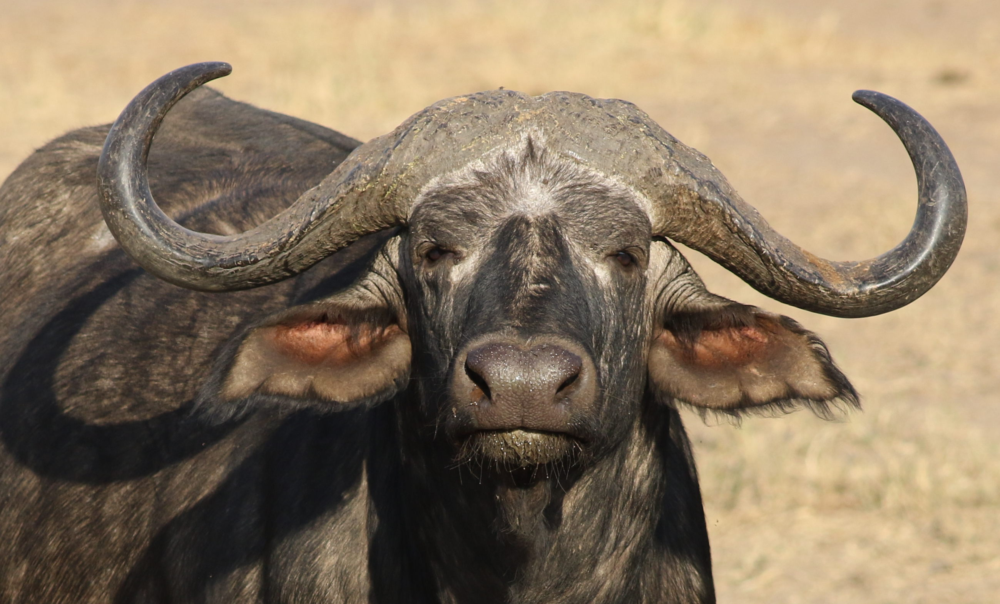

In [ ]:
pred_image = Image.fromarray(img.mul(255).permute(1, 2, 0).byte().numpy())
pred_image

In [ ]:
threshold = 0.5

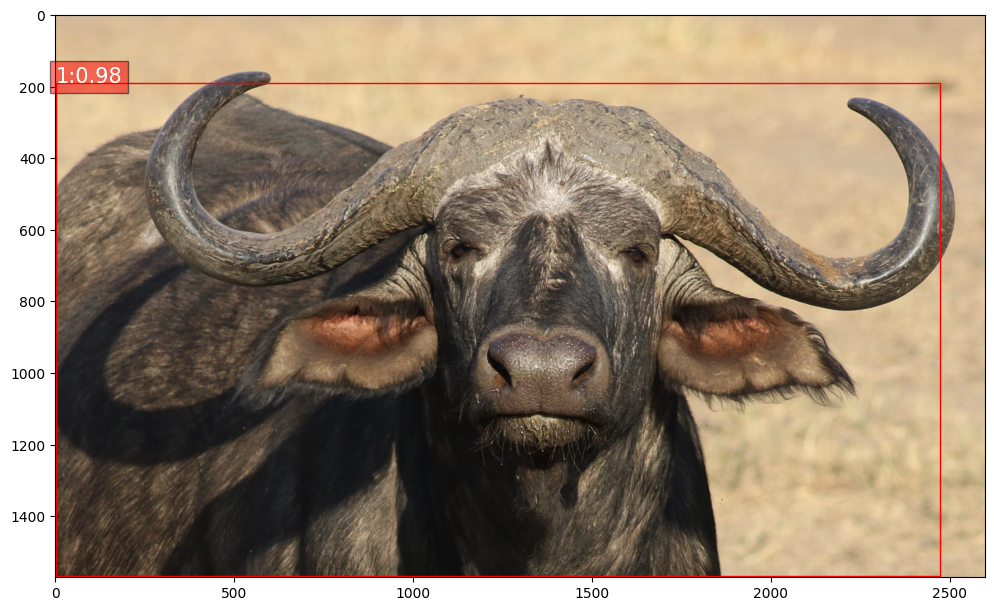

In [ ]:
plt.figure(figsize=(12,8))
pred_image_np = np.array(pred_image)
plt.imshow(pred_image_np)
ax = plt.gca()
for box, label, score in zip(prediction[0]["boxes"], prediction[0]["labels"], prediction[0]["scores"]):
    if score > threshold:
        x1, y1, x2, y2 = box.cpu().numpy()
        w = x2 - x1
        h = y2 - y1
        rect = plt.Rectangle((x1, y1), w, h, fill=False, color="red")
        ax.add_patch(rect)
        ax.text(x1, y1,  f"{label}:{score:.2f}", fontsize=15, color="white", bbox=dict(facecolor="red", alpha=0.5))
plt.show()

Disegniamo i Bounding Box reali oltre a quelli predetti

In [ ]:
plt.figure(figsize=(12,8))
pred_image_np = np.array(pred_image)
plt.imshow(pred_image_np)
ax = plt.gca()
for box in target['boxes']:
    x1, y1, x2, y2 = box.cpu().numpy()
    w = x2 - x1
    h = y2 - y1
    rect = plt.Rectangle((x1, y1), w, h, fill=False, color="blue")
    ax.add_patch(rect)

for box, label, score in zip(prediction[0]["boxes"], prediction[0]["labels"], prediction[0]["scores"]):
    if score > threshold:
        x1, y1, x2, y2 = box.cpu().numpy()
        w = x2 - x1
        h = y2 - y1
        rect = plt.Rectangle((x1, y1), w, h, fill=False, color="red")
        ax.add_patch(rect)


plt.show()

#Visualizziamo 5 immagini per ogni classe e vediamo le predizioni

In [ ]:
def get_images(dataset_test, label):
  length = len(dataset_test)
  collect = []
  for i in range(0,length):
    bool = True
    check_list = dataset_test[i][1]["labels"]

    for k in range(0,len(check_list)):
      if check_list[k] != label:
        bool = False
        break

    if bool == True:
      img, _ = dataset_test[i]
      collect.append(img)

    if len(collect) == 5:
      return collect


<Figure size 2000x1200 with 0 Axes>

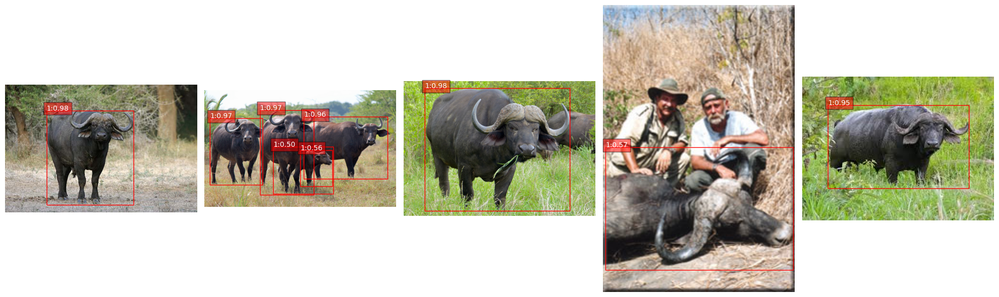

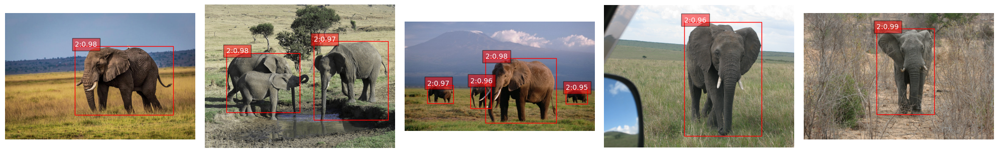

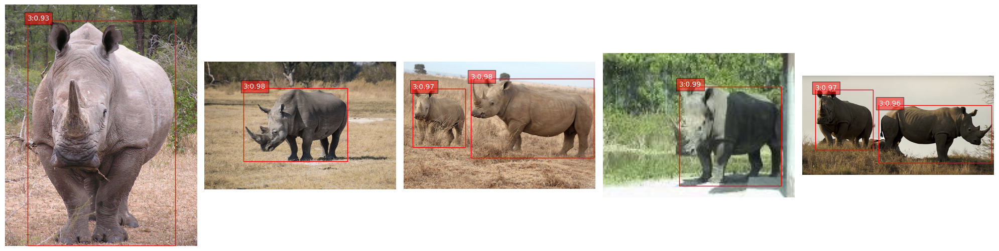

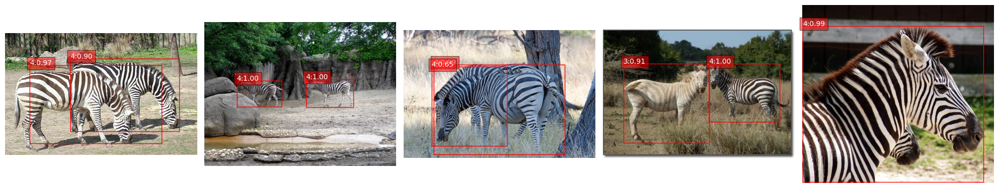

In [ ]:
plt.figure(figsize=(20, 12))
columns = 5
rows = (5 + 1) // (columns)
model.eval()

for i in range(1,5):  # Iterazione da 1 a 4 (il 5 non è compreso perché si ferma prima)
    plt.figure(figsize=(20, 12))
    list_img = get_images(dataset_test, i)

    for k in range(0,len(list_img)):
      print("\n")
      with torch.no_grad():
        prediction = model([list_img[k].to(device)])

      pred_image = Image.fromarray(list_img[k].mul(255).permute(1, 2, 0).byte().numpy())
      pred_image_np = np.array(pred_image)
      ax = plt.subplot(rows, columns, k+1)   #dividiamo il subplot  # k = 0 non è valido, quindi sommo il suo valore con 1 per evitare lo zero
      ax.imshow(pred_image_np)


      for box, label, score in zip(prediction[0]["boxes"], prediction[0]["labels"], prediction[0]["scores"]):
          if score > threshold:
              x1, y1, x2, y2 = box.cpu().numpy()
              w = x2 - x1
              h = y2 - y1
              rect = plt.Rectangle((x1, y1), w, h, fill=False, color="red")
              ax.add_patch(rect)
              ax.text(x1, y1, f"{label}:{score:.2f}", fontsize=10, color="white", bbox=dict(facecolor="red", alpha=0.5))


      ax.axis('off')
    plt.tight_layout()  #compattiamo il subplot
    plt.show()


Type img: 
 tensor([[[0.6824, 0.6824, 0.6824,  ..., 0.6588, 0.6588, 0.6588],
         [0.6824, 0.6824, 0.6824,  ..., 0.6588, 0.6588, 0.6588],
         [0.6745, 0.6745, 0.6745,  ..., 0.6588, 0.6588, 0.6588],
         ...,
         [0.7059, 0.6824, 0.7843,  ..., 0.7451, 0.7412, 0.8392],
         [0.6706, 0.7020, 0.8275,  ..., 0.7804, 0.7647, 0.8196],
         [0.6941, 0.7451, 0.8275,  ..., 0.8196, 0.8314, 0.8314]],

        [[0.7412, 0.7412, 0.7412,  ..., 0.7373, 0.7373, 0.7373],
         [0.7412, 0.7412, 0.7412,  ..., 0.7373, 0.7373, 0.7373],
         [0.7373, 0.7373, 0.7373,  ..., 0.7373, 0.7373, 0.7373],
         ...,
         [0.6275, 0.6039, 0.7059,  ..., 0.6549, 0.6549, 0.7529],
         [0.5843, 0.6157, 0.7412,  ..., 0.6902, 0.6784, 0.7333],
         [0.6078, 0.6588, 0.7412,  ..., 0.7294, 0.7451, 0.7451]],

        [[0.8706, 0.8706, 0.8706,  ..., 0.8745, 0.8745, 0.8745],
         [0.8706, 0.8706, 0.8706,  ..., 0.8745, 0.8745, 0.8745],
         [0.8667, 0.8667, 0.8667,  ..., 0.8745

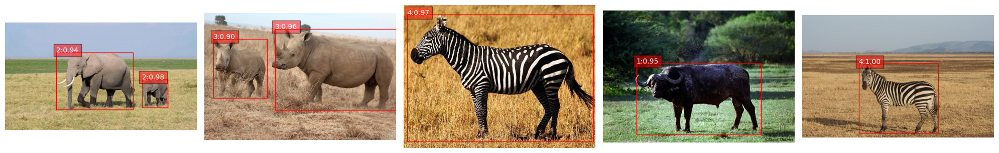

In [ ]:
import random

random.seed(42)

random_indices = random.sample(range(len(dataset_test)), 5)  #indici per prendere 5 immagini dal dataset_test in maniera random

plt.figure(figsize=(20, 12))
columns = 5
rows = (5 + 1) // (columns)

for idx, image_idx in enumerate(random_indices):

    img, target = dataset_test[image_idx]
    with torch.no_grad():
        prediction = model([img.to(device)])

    pred_image = Image.fromarray(img.mul(255).permute(1, 2, 0).byte().numpy())
    pred_image_np = np.array(pred_image)
    ax = plt.subplot(rows, columns, idx + 1)   #dividiamo il subplot
    ax.imshow(pred_image_np)


    for box, label, score in zip(prediction[0]["boxes"], prediction[0]["labels"], prediction[0]["scores"]):
        if score > threshold:
            x1, y1, x2, y2 = box.cpu().numpy()
            w = x2 - x1
            h = y2 - y1
            rect = plt.Rectangle((x1, y1), w, h, fill=False, color="red")
            ax.add_patch(rect)
            ax.text(x1, y1, f"{label}:{score:.2f}", fontsize=10, color="white", bbox=dict(facecolor="red", alpha=0.5))


    ax.axis('off')

plt.tight_layout()  #compattiamo il subplot
plt.show()
